In [5]:

import pickle
from training import Training
import torch

ModuleNotFoundError: No module named 'training'

## Testing GPT embeddings

Demographics

In [2]:

# Replace with the actual path to your pickle file
pickle_file_path = r"C:\Users\kr3164\OneDrive - Columbia University Irving Medical Center\mimic-data\mimic\final datasets\demog_gpt_emb.pickle"

# Load the pickle file
with open(pickle_file_path, 'rb') as handle:
    demog_gpt = pickle.load(handle)

In [3]:
demog_gpt

{(11325470,
  27215470): {'emb': [0.05958593264222145,
   0.012191494926810265,
   0.05403880029916763,
   0.025190677493810654,
   0.015711789950728416,
   -0.05574561282992363,
   0.023118123412132263,
   0.010271335020661354,
   -0.006758660078048706,
   -0.014477400109171867,
   0.024504905566573143,
   0.012153396382927895,
   -0.0003376472741365433,
   0.032947514206171036,
   0.026851767674088478,
   0.02206660620868206,
   0.007128214929252863,
   0.049406033009290695,
   -0.03797650709748268,
   0.013890684582293034,
   0.02552594244480133,
   0.027583258226513863,
   -0.009562703780829906,
   -0.013273490592837334,
   0.01783006079494953,
   -0.00941792968660593,
   0.006053839344531298,
   -0.07436811923980713,
   0.009219817817211151,
   0.0019068260444328189,
   0.00896074902266264,
   -0.04035384953022003,
   0.04468182846903801,
   0.000385746534448117,
   0.004701345227658749,
   0.0018620603950694203,
   0.012808689847588539,
   0.01557463500648737,
   -0.0010229425970

In [4]:
# Define input parameters
input_dim = 1536  # Assuming embeddings have 1536 dimensions
hidden_dim = 128
output_dim = 1
model_type = 'mlp'  # Example: Using an MLP model
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Initialize Training instance
trainer = Training(
    data=demog_gpt,
    model=model_type,
    input_dim=input_dim,
    hidden_dim=hidden_dim,
    output_dim=output_dim,
    device=device
)

# Train the model
best_model, train_losses, val_losses = trainer.training(lr=0.000001, num_epochs=1000, patience=10)


Epoch [1/1000], Train Loss: 83.4403
Epoch [1/1000], Val Loss: 80.9218
Updating best loss: Previous inf, New 80.9218
Epoch [2/1000], Train Loss: 80.9968
Epoch [2/1000], Val Loss: 78.4639
Updating best loss: Previous 80.9218, New 78.4639
Epoch [3/1000], Train Loss: 78.4914
Epoch [3/1000], Val Loss: 75.9319
Updating best loss: Previous 78.4639, New 75.9319
Epoch [4/1000], Train Loss: 75.9321
Epoch [4/1000], Val Loss: 73.3637
Updating best loss: Previous 75.9319, New 73.3637
Epoch [5/1000], Train Loss: 73.3566
Epoch [5/1000], Val Loss: 70.8020
Updating best loss: Previous 73.3637, New 70.8020
Epoch [6/1000], Train Loss: 70.8057
Epoch [6/1000], Val Loss: 68.2815
Updating best loss: Previous 70.8020, New 68.2815
Epoch [7/1000], Train Loss: 68.3093
Epoch [7/1000], Val Loss: 65.8458
Updating best loss: Previous 68.2815, New 65.8458
Epoch [8/1000], Train Loss: 65.9269
Epoch [8/1000], Val Loss: 63.5405
Updating best loss: Previous 65.8458, New 63.5405
Epoch [9/1000], Train Loss: 63.6886
Epoch [9

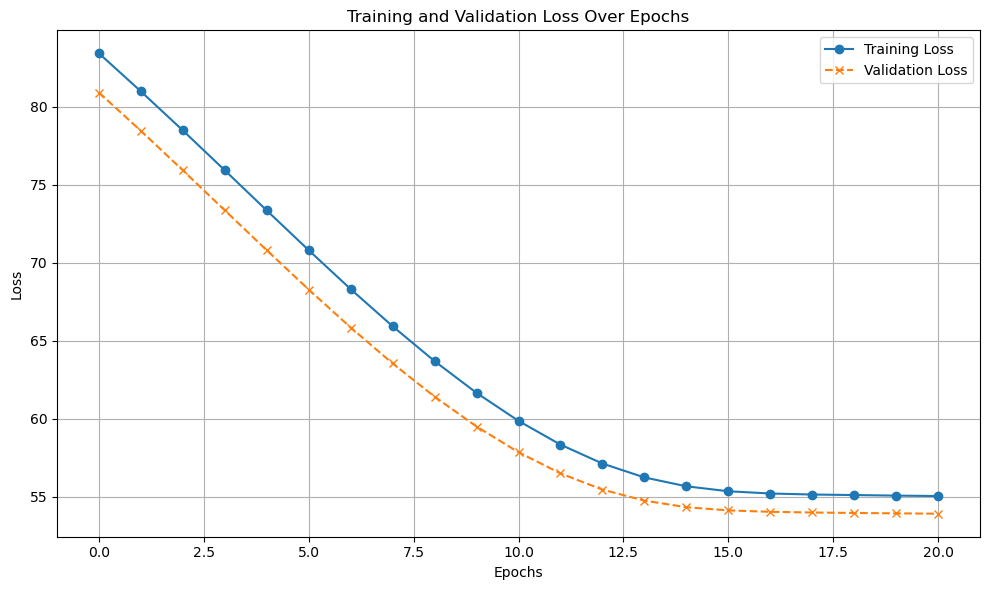

In [9]:
import matplotlib.pyplot as plt
def plot_losses(train_losses, val_losses):
    """
    Plot training and validation losses.

    :param train_losses: List of training loss values
    :param val_losses: List of validation loss values
    """
    plt.figure(figsize=(10, 6))
    plt.plot(train_losses, label="Training Loss", linestyle='-', marker='o')
    plt.plot(val_losses, label="Validation Loss", linestyle='--', marker='x')
    plt.xlabel("Epochs")
    plt.ylabel("Loss")
    plt.title("Training and Validation Loss Over Epochs")
    plt.legend()
    plt.grid()
    plt.tight_layout()
    plt.show()

# Call the plotting function
plot_losses(train_losses, val_losses)

In [11]:
all_outputs, all_labels = [], []
trainer.model.eval()  # Set model to evaluation mode

with torch.no_grad():
    for embeddings, labels in trainer.data_splits.val_loader:
        embeddings, labels = embeddings.to(device), labels.float().to(device)

        # Generate the mask
        mask = (embeddings != 0).bool()

        # Model predictions with mask
        outputs = trainer.model(embeddings, mask)
        all_outputs.extend(outputs.cpu().numpy().flatten())  # Flatten to 1D array
        all_labels.extend(labels.cpu().numpy())


In [15]:
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import numpy as np

# Convert to NumPy arrays if not already
all_labels = np.array(all_labels)
all_outputs = np.array(all_outputs)

# Averages
average_labels = np.mean(all_labels)
average_outputs = np.mean(all_outputs)
print(f"Average of Labels: {average_labels:.4f}")
print(f"Average of Outputs: {average_outputs:.4f}")

# Mean Absolute Error (MAE)
mae = mean_absolute_error(all_labels, all_outputs)
print(f"Mean Absolute Error (MAE): {mae:.4f}")

# Mean Squared Error (MSE)
mse = mean_squared_error(all_labels, all_outputs)
print(f"Mean Squared Error (MSE): {mse:.4f}")

# Root Mean Squared Error (RMSE)
rmse = np.sqrt(mse)
print(f"Root Mean Squared Error (RMSE): {rmse:.4f}")

# R-squared (R²)
r2 = r2_score(all_labels, all_outputs)
print(f"R-squared (R²): {r2:.4f}")

# Mean Absolute Percentage Error (MAPE) - Optional
def mean_absolute_percentage_error(y_true, y_pred):
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

mape = mean_absolute_percentage_error(all_labels, all_outputs)
print(f"Mean Absolute Percentage Error (MAPE): {mape:.2f}%")


Average of Labels: 5.4454
Average of Outputs: 5.4006
Mean Absolute Error (MAE): 3.9910
Mean Squared Error (MSE): 53.8262
Root Mean Squared Error (RMSE): 7.3366
R-squared (R²): -0.0035
Mean Absolute Percentage Error (MAPE): 205.54%


## ICD Code

In [3]:

pickle_file_path = r"C:\Users\kr3164\OneDrive - Columbia University Irving Medical Center\mimic-data\mimic\final datasets\icd_code_gpt_emb.pickle"

# Load the pickle file
with open(pickle_file_path, 'rb') as handle:
    icd_code_gpt = pickle.load(handle)

In [5]:
# Define input parameters
input_dim = 1536  # Assuming embeddings have 1536 dimensions
hidden_dim = 128
output_dim = 1
model_type = 'mlp'  # Example: Using an MLP model
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Initialize Training instance
trainer = Training(
    data=icd_code_gpt,
    model=model_type,
    input_dim=input_dim,
    hidden_dim=hidden_dim,
    output_dim=output_dim,
    device=device
)

# Train the model
best_model, train_losses, val_losses = trainer.training(lr=0.000001, num_epochs=1000, patience=10)


Epoch [1/1000], Train Loss: 84.1641
Epoch [1/1000], Val Loss: 81.0872
Updating best loss: Previous inf, New 81.0872
Epoch [2/1000], Train Loss: 81.7763
Epoch [2/1000], Val Loss: 78.6403
Updating best loss: Previous 81.0872, New 78.6403
Epoch [3/1000], Train Loss: 79.3004
Epoch [3/1000], Val Loss: 76.0926
Updating best loss: Previous 78.6403, New 76.0926
Epoch [4/1000], Train Loss: 76.7216
Epoch [4/1000], Val Loss: 73.4219
Updating best loss: Previous 76.0926, New 73.4219
Epoch [5/1000], Train Loss: 74.0441
Epoch [5/1000], Val Loss: 70.7083
Updating best loss: Previous 73.4219, New 70.7083
Epoch [6/1000], Train Loss: 71.3547
Epoch [6/1000], Val Loss: 67.9968
Updating best loss: Previous 70.7083, New 67.9968
Epoch [7/1000], Train Loss: 68.6959
Epoch [7/1000], Val Loss: 65.3437
Updating best loss: Previous 67.9968, New 65.3437
Epoch [8/1000], Train Loss: 66.1244
Epoch [8/1000], Val Loss: 62.7940
Updating best loss: Previous 65.3437, New 62.7940
Epoch [9/1000], Train Loss: 63.6928
Epoch [9

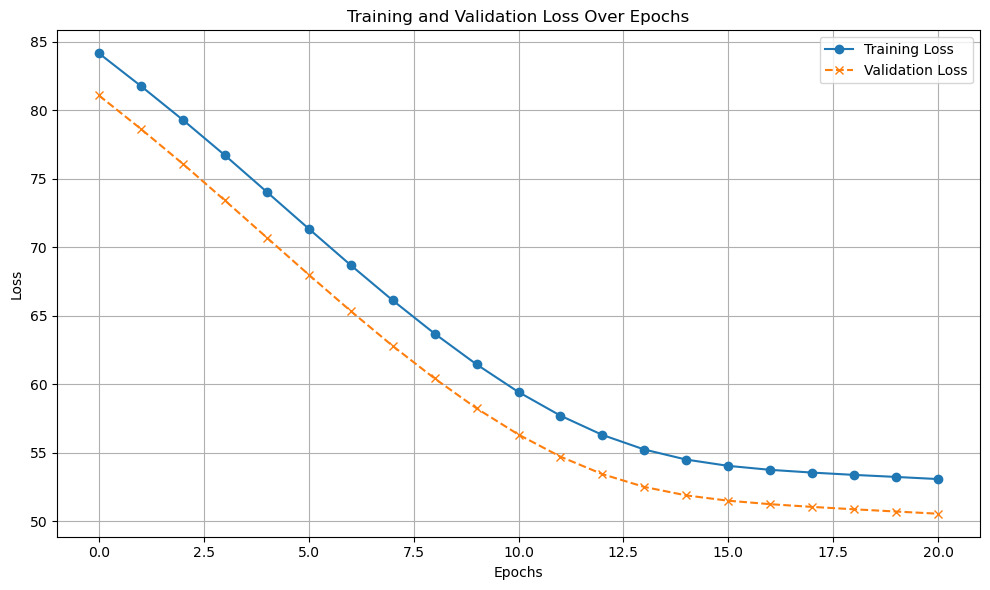

In [6]:
import matplotlib.pyplot as plt
def plot_losses(train_losses, val_losses):
    """
    Plot training and validation losses.

    :param train_losses: List of training loss values
    :param val_losses: List of validation loss values
    """
    plt.figure(figsize=(10, 6))
    plt.plot(train_losses, label="Training Loss", linestyle='-', marker='o')
    plt.plot(val_losses, label="Validation Loss", linestyle='--', marker='x')
    plt.xlabel("Epochs")
    plt.ylabel("Loss")
    plt.title("Training and Validation Loss Over Epochs")
    plt.legend()
    plt.grid()
    plt.tight_layout()
    plt.show()

# Call the plotting function
plot_losses(train_losses, val_losses)

In [7]:
all_outputs, all_labels = [], []
trainer.model.eval()  # Set model to evaluation mode

with torch.no_grad():
    for embeddings, labels in trainer.data_splits.val_loader:
        embeddings, labels = embeddings.to(device), labels.float().to(device)

        # Generate the mask
        mask = (embeddings != 0).bool()

        # Model predictions with mask
        outputs = trainer.model(embeddings, mask)
        all_outputs.extend(outputs.cpu().numpy().flatten())  # Flatten to 1D array
        all_labels.extend(labels.cpu().numpy())

In [8]:
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import numpy as np

# Convert to NumPy arrays if not already
all_labels = np.array(all_labels)
all_outputs = np.array(all_outputs)

# Averages
average_labels = np.mean(all_labels)
average_outputs = np.mean(all_outputs)
print(f"Average of Labels: {average_labels:.4f}")
print(f"Average of Outputs: {average_outputs:.4f}")

# Mean Absolute Error (MAE)
mae = mean_absolute_error(all_labels, all_outputs)
print(f"Mean Absolute Error (MAE): {mae:.4f}")

# Mean Squared Error (MSE)
mse = mean_squared_error(all_labels, all_outputs)
print(f"Mean Squared Error (MSE): {mse:.4f}")

# Root Mean Squared Error (RMSE)
rmse = np.sqrt(mse)
print(f"Root Mean Squared Error (RMSE): {rmse:.4f}")

# R-squared (R²)
r2 = r2_score(all_labels, all_outputs)
print(f"R-squared (R²): {r2:.4f}")

# Mean Absolute Percentage Error (MAPE) - Optional
def mean_absolute_percentage_error(y_true, y_pred):
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

mape = mean_absolute_percentage_error(all_labels, all_outputs)
print(f"Mean Absolute Percentage Error (MAPE): {mape:.2f}%")


Average of Labels: 5.5087
Average of Outputs: 5.4815
Mean Absolute Error (MAE): 3.9065
Mean Squared Error (MSE): 50.5680
Root Mean Squared Error (RMSE): 7.1111
R-squared (R²): 0.0441
Mean Absolute Percentage Error (MAPE): 177.63%


ICD Name

In [1]:

pickle_file_path = r"C:\Users\kr3164\OneDrive - Columbia University Irving Medical Center\mimic-data\mimic\final datasets\icd_name_gpt_emb.pickle"

# Load the pickle file
with open(pickle_file_path, 'rb') as handle:
    icd_name_gpt = pickle.load(handle)

NameError: name 'pickle' is not defined